### Load necessary libraries

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm import tqdm
import random

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img, smart_resize
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

In [33]:
directory = './Anime Faces/images/'
size = 23349

#### Load Images

In [34]:
image_paths = []

for filename in os.listdir(directory):
    image_path = os.path.join(directory, filename)
    image_paths.append(image_path)

image_paths = image_paths[:size]

In [35]:
image_paths[:5]

['./Anime Faces/images/0_2000.jpg',
 './Anime Faces/images/10000_2004.jpg',
 './Anime Faces/images/10001_2004.jpg',
 './Anime Faces/images/10002_2004.jpg',
 './Anime Faces/images/10003_2004.jpg']

**Number of images**

In [36]:
len(image_paths)

23349

#### Visualize the images

In [37]:
random_images = []

for i in range(64):
    random_images.append(random.choice(image_paths))

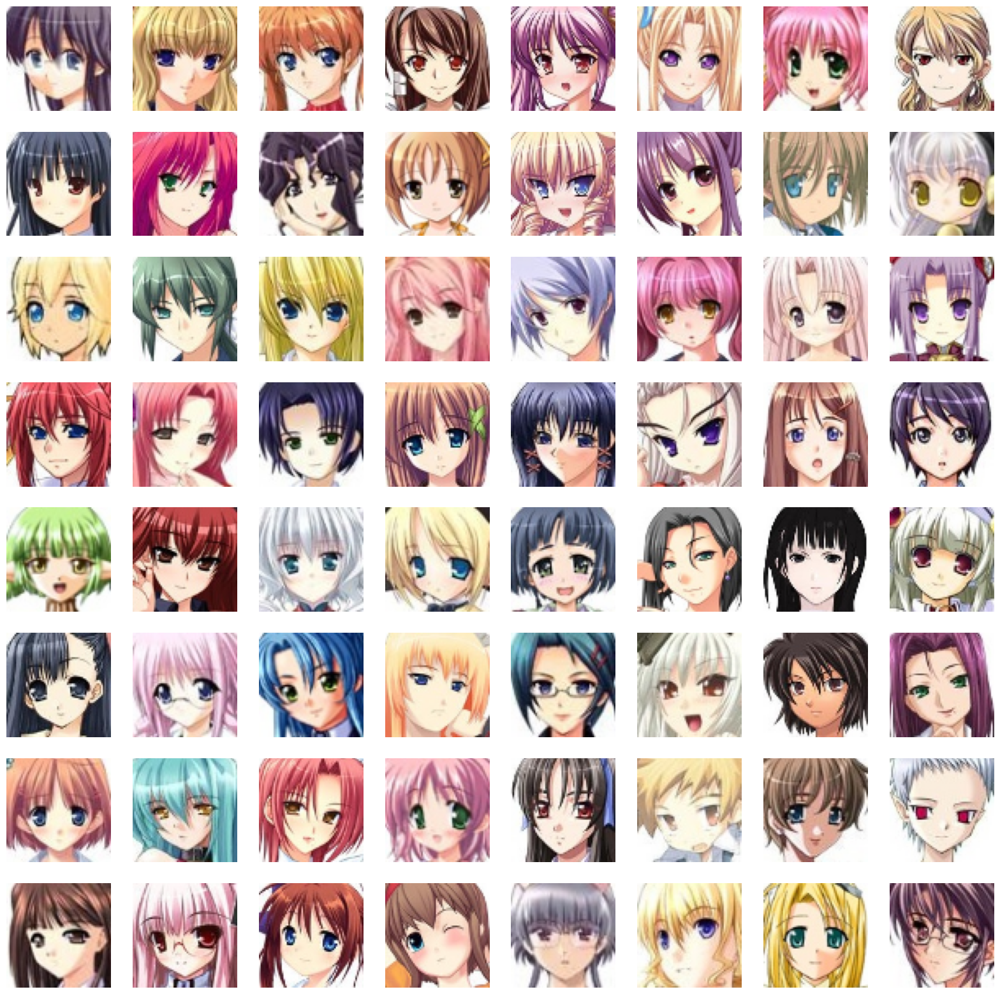

In [38]:
# make a grid
plt.figure(figsize = (20, 20))
index = 1

for image in random_images:
    plt.subplot(8, 8, index)

    # load image
    img = load_img(image)
    img = np.array(img)

    # resize to 64x64
    img = smart_resize(img, size = (64, 64))

    # rescale to [0, 1] for float values
    img = img / 255.0

    plt.imshow(img)
    plt.axis('off')
    
    index += 1

### Preprocess all images

In [39]:
train_images = []

for image_path in tqdm(image_paths):
    img = np.array(load_img(image_path))
    img = smart_resize(img, size = (64, 64))
    img = img / 255.0
    train_images.append(img)

train_images = np.array(train_images)

100%|████████████████████████████████████████████████████████████████████████████| 23349/23349 [04:38<00:00, 83.95it/s]


**Shape of images**

In [40]:
train_images[0].shape

(64, 64, 3)

**Represent each image as 3D tensor**

In [41]:
train_images = train_images.reshape(train_images.shape[0], 64, 64, 3).astype('float32')

In [42]:
train_images.shape

(23349, 64, 64, 3)

***Normalize images [-1, 1]***

$$new\_value = (old\_value - old\_min) * \frac{new\_max - new\_min}{old\_max - old\_min} + new\_min$$

In [43]:
train_images = (train_images - 0.5) * 2

In [44]:
train_images.min()

-1.0

In [45]:
train_images.max()

1.0

In [46]:
train_images[0]

array([[[ 0.6784314 ,  0.654902  ,  0.6156863 ],
        [ 0.6707721 ,  0.64724267,  0.59270835],
        [ 0.8288603 ,  0.7751838 ,  0.7278186 ],
        ...,
        [ 0.99969363,  0.7876226 ,  0.74871325],
        [ 0.9917892 ,  0.7721814 ,  0.74099267],
        [ 0.9764706 ,  0.75686276,  0.73333335]],

       [[ 0.8469362 ,  0.8080882 ,  0.7612132 ],
        [ 0.9290346 ,  0.89018655,  0.8429525 ],
        [ 0.99359536,  0.9761212 ,  0.9143349 ],
        ...,
        [ 0.99233353,  0.7355033 ,  0.66595674],
        [ 0.9923278 ,  0.7579398 ,  0.6966524 ],
        [ 0.99944854,  0.7875    ,  0.7563113 ]],

       [[ 0.9188113 ,  0.84944856,  0.794853  ],
        [ 0.9809834 ,  0.9116206 ,  0.8423048 ],
        [ 0.99207306,  0.9163512 ,  0.8460933 ],
        ...,
        [ 0.98491454,  0.7041054 ,  0.61150765],
        [ 0.9923407 ,  0.7278043 ,  0.6505443 ],
        [ 1.        ,  0.77316177,  0.7191789 ]],

       ...,

       [[-0.08866423, -0.16770834,  0.5068015 ],
        [-0

### Make Models - Discriminator & Generator

In [47]:
# dimensions for noise
LATENT_DIMS = 100

# channels - colour image
CHANNELS = 3

# weight initializer
WEIGHT_INIT = keras.initializers.RandomNormal(mean = 0.0, stddev = 0.02)

#### Generator

In [48]:
model = Sequential(name = 'generator')

# 1D random noise
model.add(layers.Dense(8 * 8 * 512, input_dim = LATENT_DIMS))
model.add(layers.ReLU())

# convert 1D to 3D
model.add(layers.Reshape((8, 8, 512)))

# upscale to 16x16
model.add(layers.Conv2DTranspose(256, (4, 4), strides = (2, 2), padding = 'same', kernel_initializer = WEIGHT_INIT))
model.add(layers.ReLU())

# upscale to 32x32
model.add(layers.Conv2DTranspose(128, (4, 4), strides = (2, 2), padding = 'same', kernel_initializer = WEIGHT_INIT))
model.add(layers.ReLU())

# upscale to 64x64
model.add(layers.Conv2DTranspose(64, (4, 4), strides = (2, 2), padding = 'same', kernel_initializer = WEIGHT_INIT))
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding = 'same', activation = 'tanh'))

generator = model
generator.summary()

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_2 (Dense)             (None, 32768)             3309568   
                                                                 
 re_lu_4 (ReLU)              (None, 32768)             0         
                                                                 
 reshape_1 (Reshape)         (None, 8, 8, 512)         0         
                                                                 
 conv2d_transpose_3 (Conv2DT  (None, 16, 16, 256)      2097408   
 ranspose)                                                       
                                                                 
 re_lu_5 (ReLU)              (None, 16, 16, 256)       0         
                                                                 
 conv2d_transpose_4 (Conv2DT  (None, 32, 32, 128)      524416    
 ranspose)                                               

#### Discriminator

In [49]:
input_shape = (64, 64, 3)
alpha = 0.2

model = Sequential(name = 'discriminator')

# convolutional layers
model.add(layers.Conv2D(64, (4, 4), strides = (2, 2), padding = 'same', input_shape = input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha = alpha))

model.add(layers.Conv2D(128, (4, 4), strides = (2, 2), padding = 'same', input_shape = input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha = alpha))

model.add(layers.Conv2D(128, (4, 4), strides = (2, 2), padding = 'same', input_shape = input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha = alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# output
model.add(layers.Dense(1, activation = 'sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_5 (Conv2D)           (None, 32, 32, 64)        3136      
                                                                 
 batch_normalization_3 (Batc  (None, 32, 32, 64)       256       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_3 (LeakyReLU)   (None, 32, 32, 64)        0         
                                                                 
 conv2d_6 (Conv2D)           (None, 16, 16, 128)       131200    
                                                                 
 batch_normalization_4 (Batc  (None, 16, 16, 128)      512       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 16, 16, 128)     

### Make the GAN 

In [50]:
class GAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dims):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dims = latent_dims
        self.g_loss_metric = keras.metrics.Mean(name = 'g_loss')
        self.d_loss_metric = keras.metrics.Mean(name = 'd_loss')

    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]

    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(GAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn

    def train_step(self, real_images):
        batch_size = tf.shape(real_images)[0]

        # generate noise
        random_noise = tf.random.normal(shape = (batch_size, self.latent_dims))

        # train discriminator | fake = 0 & real = 1
        with tf.GradientTape() as tape:
            # loss on real images
            pred_real = self.discriminator(real_images, training = True)

            # real image labels
            real_labels = tf.ones((batch_size, 1))

            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)


            # loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training = True)

            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)

            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2

        # discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)

        # update gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))


        # train generator model
        labels = tf.ones((batch_size, 1))

        with tf.GradientTape() as tape:
            # generate fake images
            fake_images = self.generator(random_noise, training = True)
            pred_fake = self.discriminator(fake_images, training = True)

            g_loss = self.loss_fn(labels, pred_fake)

        # gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)

        # update gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))

        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

#### Utility class to plot images after each epoch

In [51]:
class GANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs = 25, latent_dims = 100):
        self.num_imgs = num_imgs
        self.latent_dims = latent_dims
        self.noise = tf.random.normal([25, latent_dims])

    def on_epoch_end(self, epoch, logs = None):
        # generate image from noise
        g_img = self.model.generator(self.noise)

        # denormalize image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()

        fig = plt.figure(figsize = (8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i + 1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
            
        plt.show()     

    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

### Training

**Initialize the model**

In [52]:
gan = GAN(generator = generator, discriminator = discriminator, latent_dims = LATENT_DIMS)

**Compile the model**

In [53]:
G_LR = 0.0003
D_LR = 0.0001

gan.compile(g_optimizer = Adam(learning_rate = G_LR, beta_1 = 0.5),
            d_optimizer = Adam(learning_rate = D_LR, beta_1 = 0.5),
            loss_fn = BinaryCrossentropy())

**Train**

In [54]:
EPOCHS = 50

Epoch 1/50
730/730 [==============================] - ETA: 0s - d_loss: 0.6533 - g_loss: 2.6347

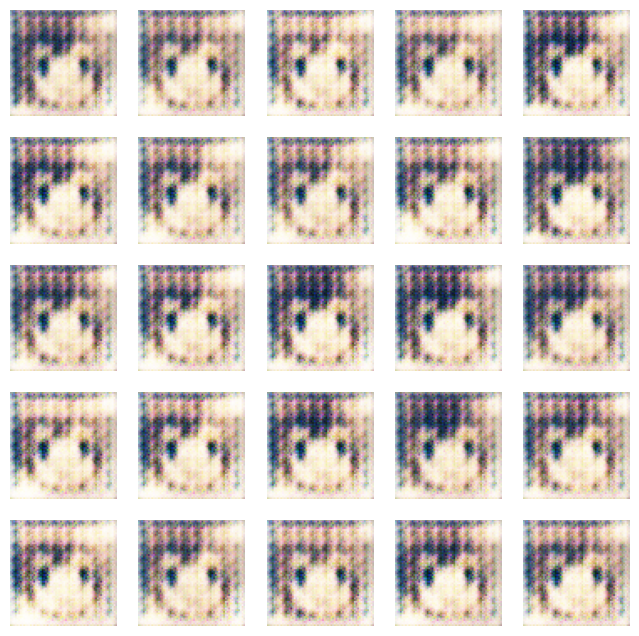

730/730 [==============================] - 81s 85ms/step - d_loss: 0.6533 - g_loss: 2.6347
Epoch 2/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5571 - g_loss: 1.8116

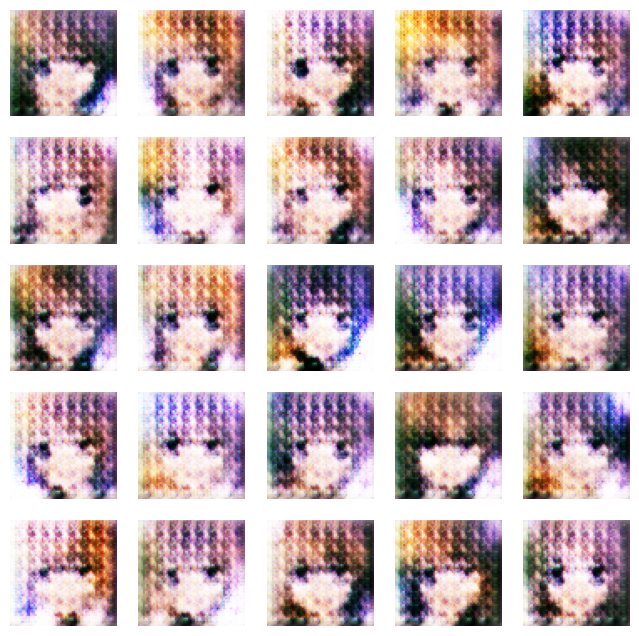

730/730 [==============================] - 59s 81ms/step - d_loss: 0.5571 - g_loss: 1.8116
Epoch 3/50
730/730 [==============================] - ETA: 0s - d_loss: 0.6341 - g_loss: 1.5781

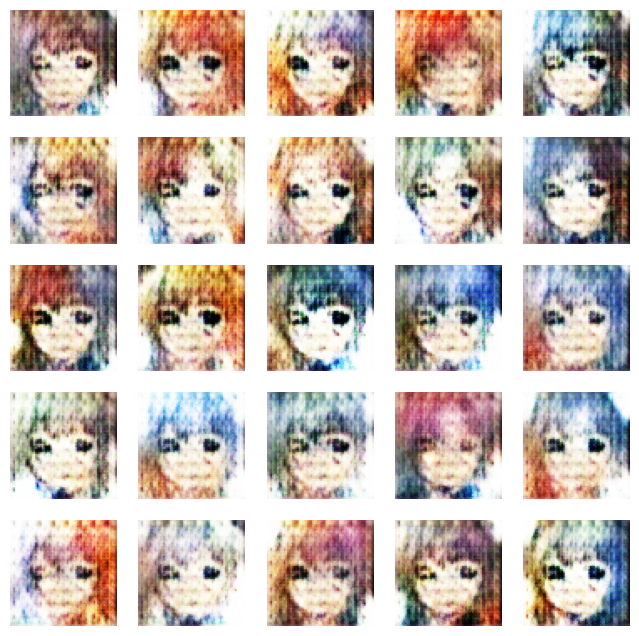

730/730 [==============================] - 58s 80ms/step - d_loss: 0.6341 - g_loss: 1.5781
Epoch 4/50
730/730 [==============================] - ETA: 0s - d_loss: 0.6640 - g_loss: 1.4395

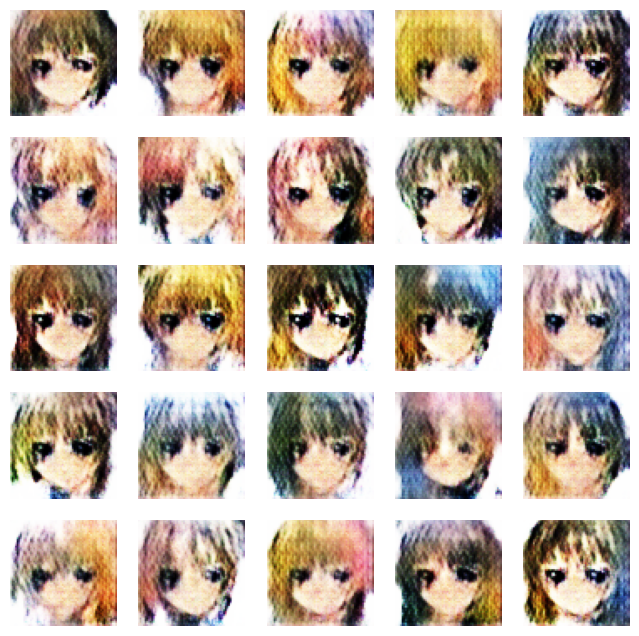

730/730 [==============================] - 58s 80ms/step - d_loss: 0.6640 - g_loss: 1.4395
Epoch 5/50
730/730 [==============================] - ETA: 0s - d_loss: 0.6567 - g_loss: 1.4080

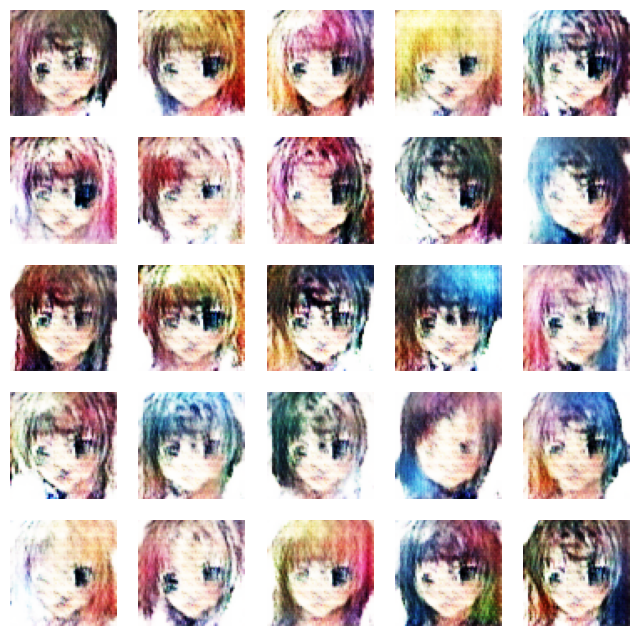

730/730 [==============================] - 58s 80ms/step - d_loss: 0.6567 - g_loss: 1.4080
Epoch 6/50
730/730 [==============================] - ETA: 0s - d_loss: 0.6239 - g_loss: 1.4582

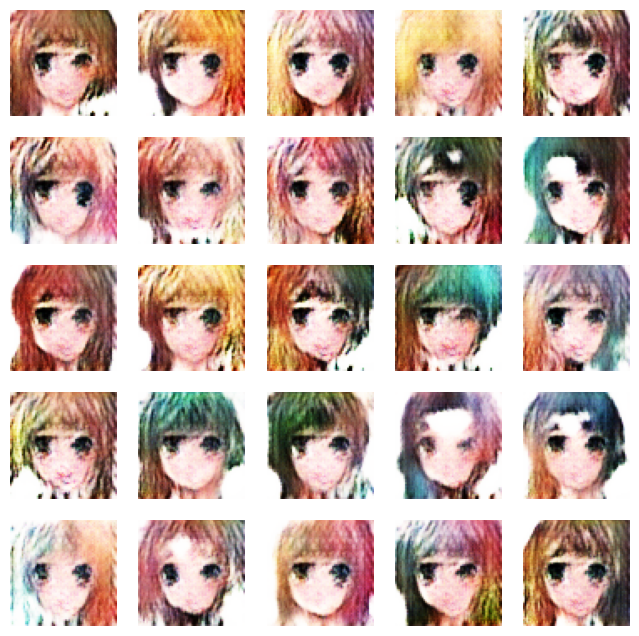

730/730 [==============================] - 58s 80ms/step - d_loss: 0.6239 - g_loss: 1.4582
Epoch 7/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5928 - g_loss: 1.5333

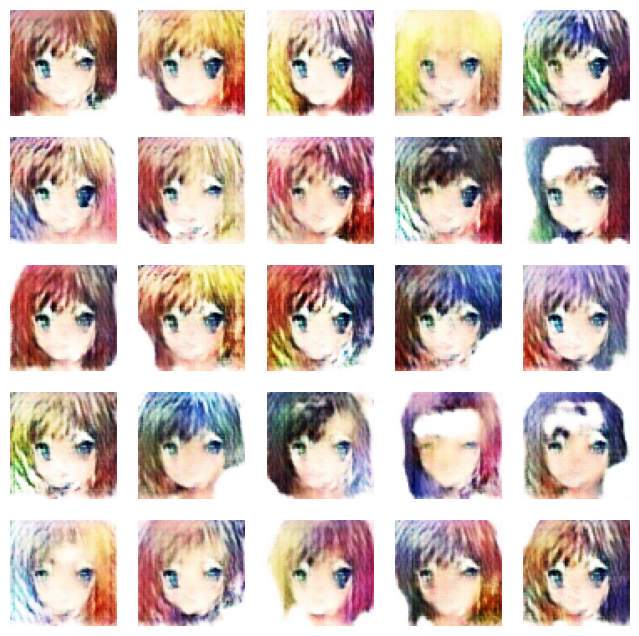

730/730 [==============================] - 58s 80ms/step - d_loss: 0.5928 - g_loss: 1.5333
Epoch 8/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5870 - g_loss: 1.5832

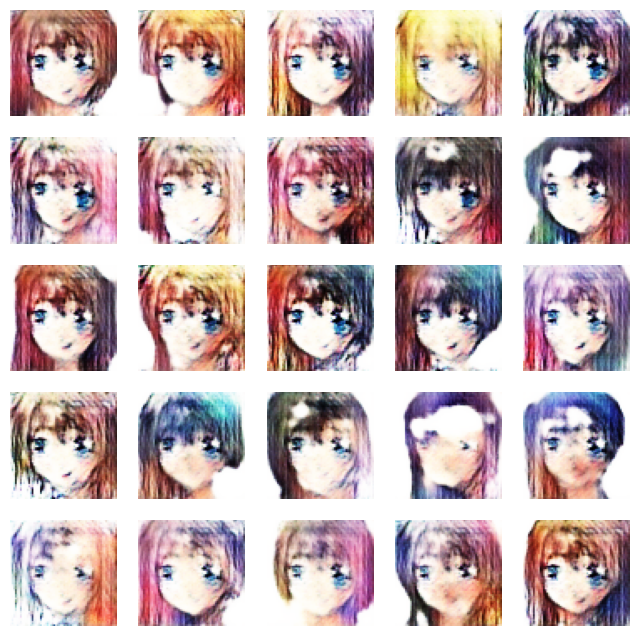

730/730 [==============================] - 59s 80ms/step - d_loss: 0.5870 - g_loss: 1.5832
Epoch 9/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5685 - g_loss: 1.6796

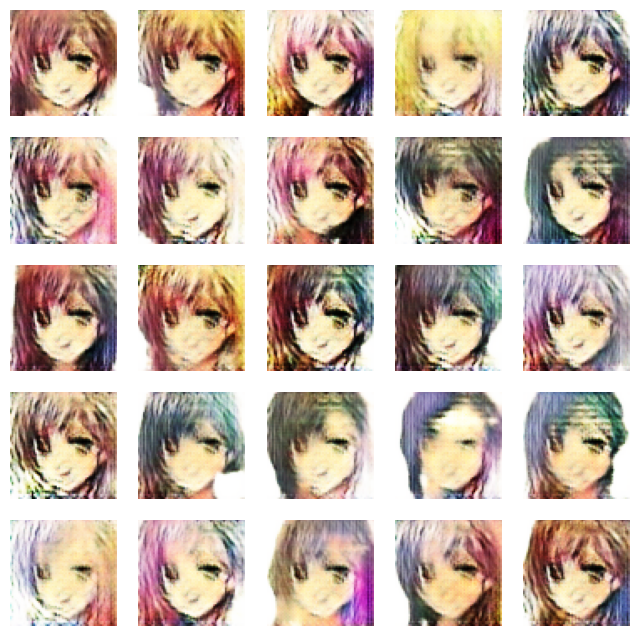

730/730 [==============================] - 58s 80ms/step - d_loss: 0.5685 - g_loss: 1.6796
Epoch 10/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5557 - g_loss: 1.7528

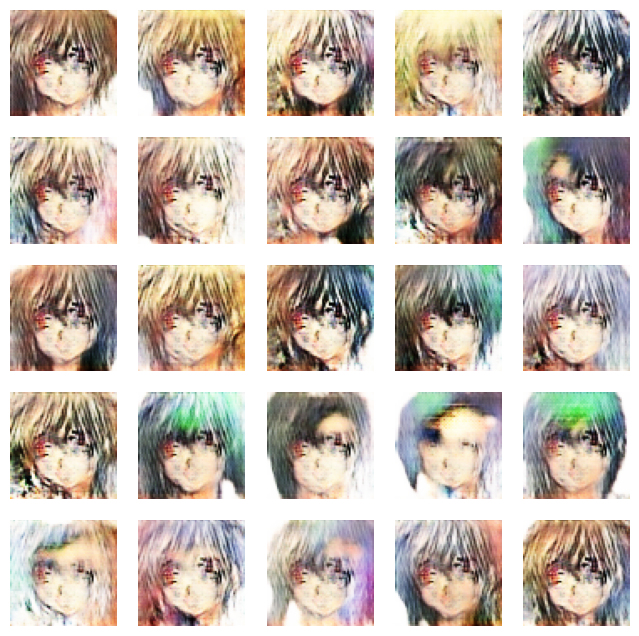

730/730 [==============================] - 58s 80ms/step - d_loss: 0.5557 - g_loss: 1.7528
Epoch 11/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5462 - g_loss: 1.7305

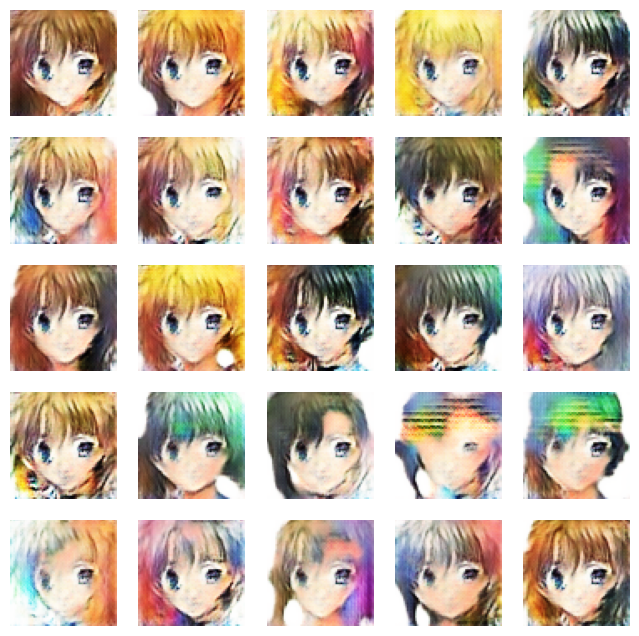

730/730 [==============================] - 58s 80ms/step - d_loss: 0.5462 - g_loss: 1.7305
Epoch 12/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5319 - g_loss: 1.7812

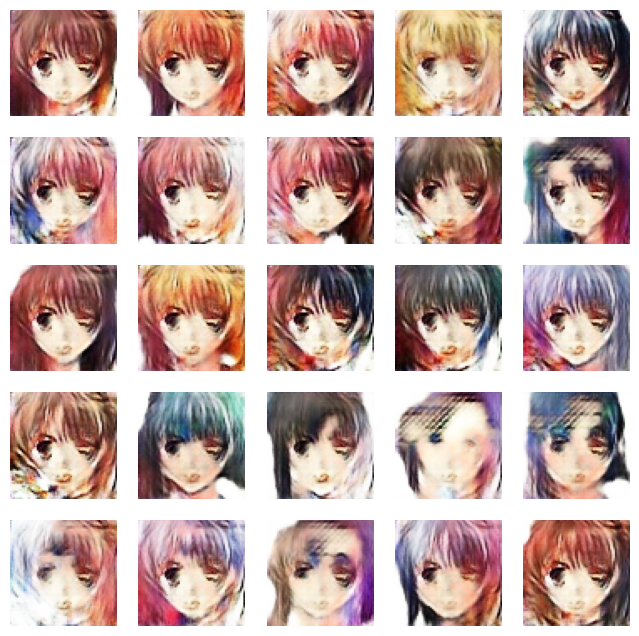

730/730 [==============================] - 58s 80ms/step - d_loss: 0.5319 - g_loss: 1.7812
Epoch 13/50
730/730 [==============================] - ETA: 0s - d_loss: 0.4938 - g_loss: 1.8225

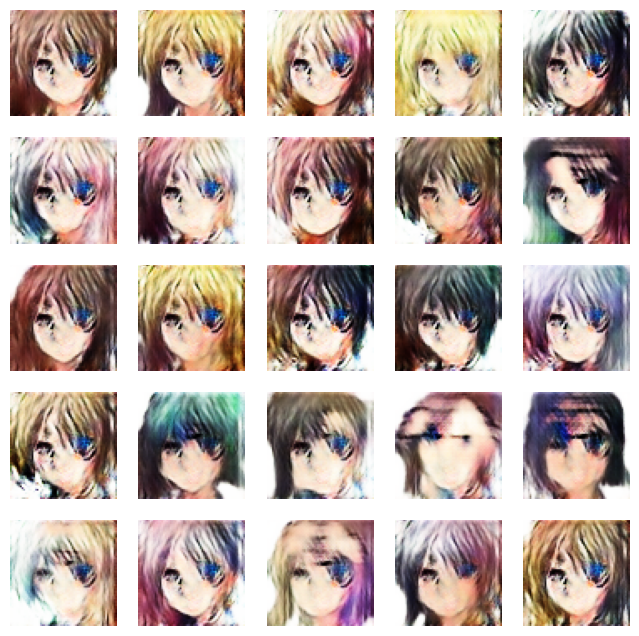

730/730 [==============================] - 58s 80ms/step - d_loss: 0.4938 - g_loss: 1.8225
Epoch 14/50
730/730 [==============================] - ETA: 0s - d_loss: 0.4899 - g_loss: 1.8813

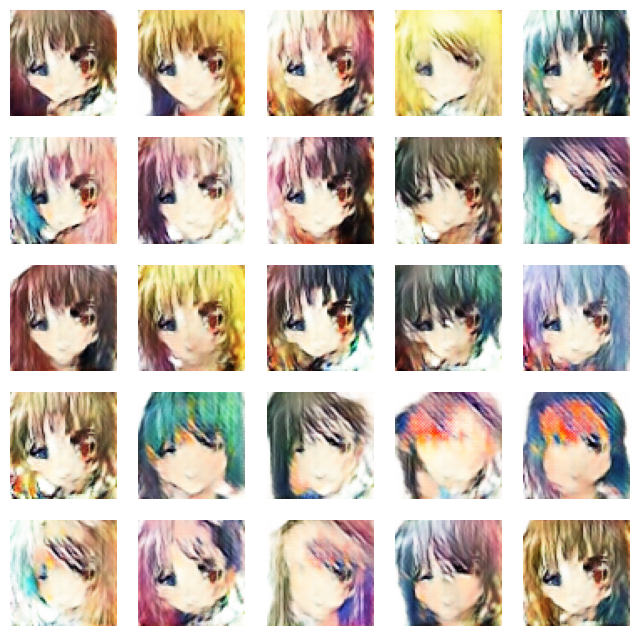

730/730 [==============================] - 58s 80ms/step - d_loss: 0.4899 - g_loss: 1.8813
Epoch 15/50
730/730 [==============================] - ETA: 0s - d_loss: 0.4716 - g_loss: 1.9004

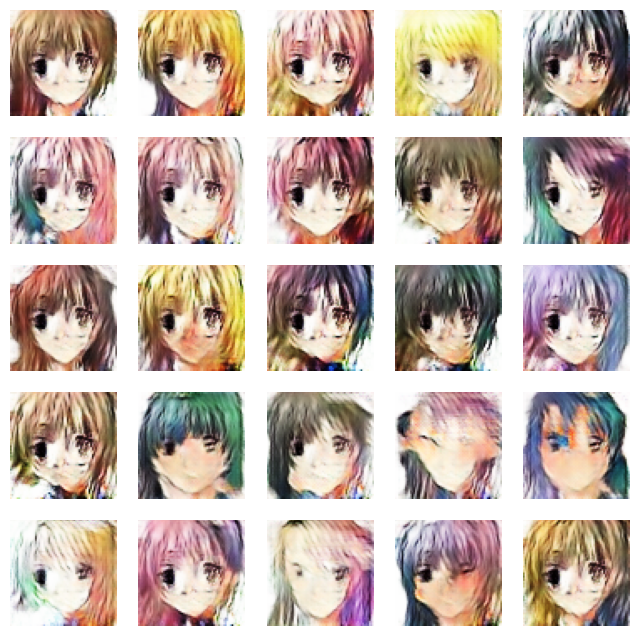

730/730 [==============================] - 58s 80ms/step - d_loss: 0.4716 - g_loss: 1.9004
Epoch 16/50
730/730 [==============================] - ETA: 0s - d_loss: 0.4873 - g_loss: 1.8667

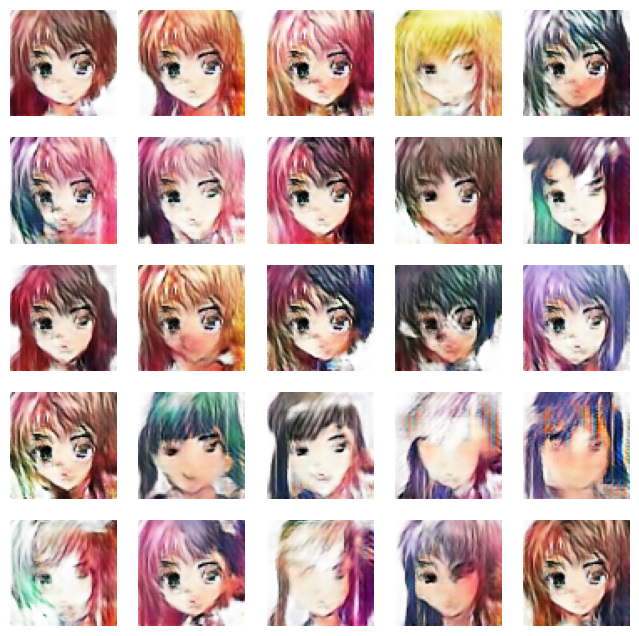

730/730 [==============================] - 58s 80ms/step - d_loss: 0.4873 - g_loss: 1.8667
Epoch 17/50
730/730 [==============================] - ETA: 0s - d_loss: 0.4796 - g_loss: 1.8465

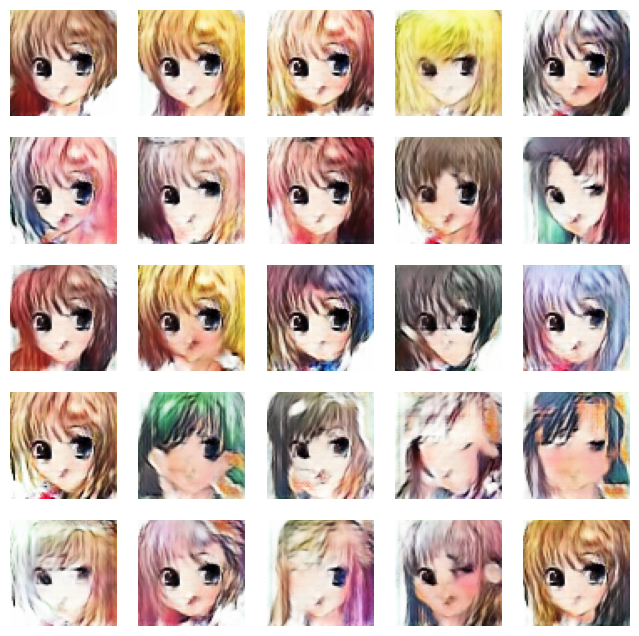

730/730 [==============================] - 58s 80ms/step - d_loss: 0.4796 - g_loss: 1.8465
Epoch 18/50
730/730 [==============================] - ETA: 0s - d_loss: 0.4853 - g_loss: 1.8224

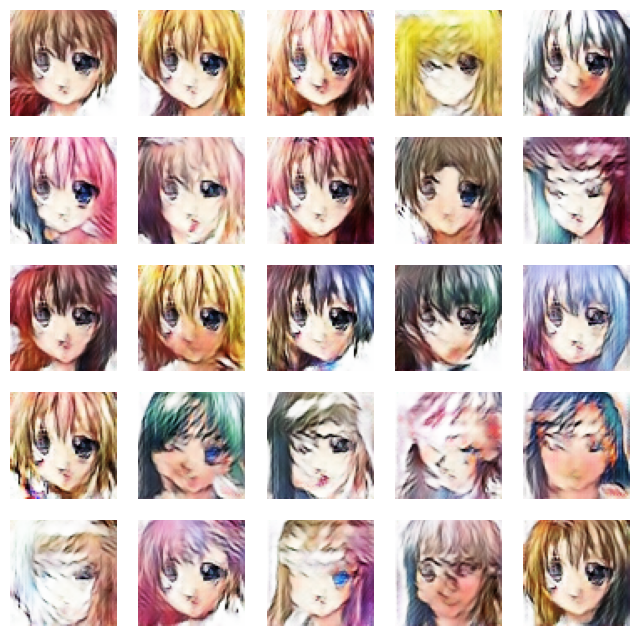

730/730 [==============================] - 58s 80ms/step - d_loss: 0.4853 - g_loss: 1.8224
Epoch 19/50
730/730 [==============================] - ETA: 0s - d_loss: 0.4788 - g_loss: 1.8257

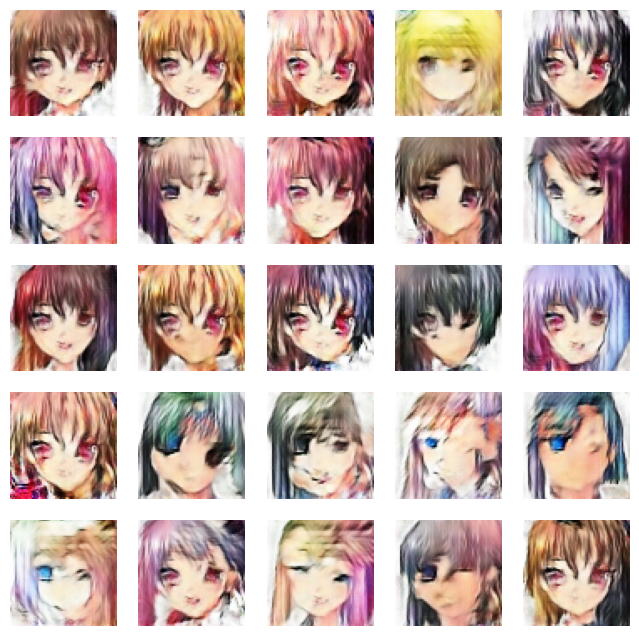

730/730 [==============================] - 58s 80ms/step - d_loss: 0.4788 - g_loss: 1.8257
Epoch 20/50
730/730 [==============================] - ETA: 0s - d_loss: 0.4752 - g_loss: 1.8146

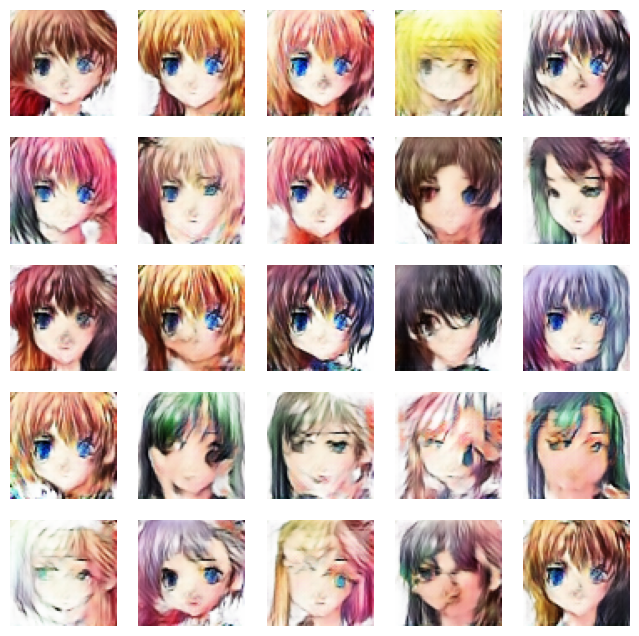

730/730 [==============================] - 58s 79ms/step - d_loss: 0.4752 - g_loss: 1.8146
Epoch 21/50
730/730 [==============================] - ETA: 0s - d_loss: 0.4692 - g_loss: 1.7918

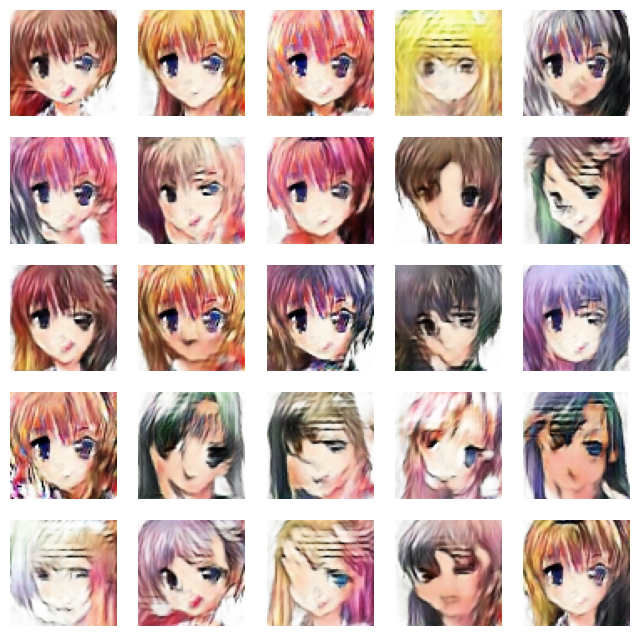

730/730 [==============================] - 58s 80ms/step - d_loss: 0.4692 - g_loss: 1.7918
Epoch 22/50
730/730 [==============================] - ETA: 0s - d_loss: 0.4742 - g_loss: 1.7995

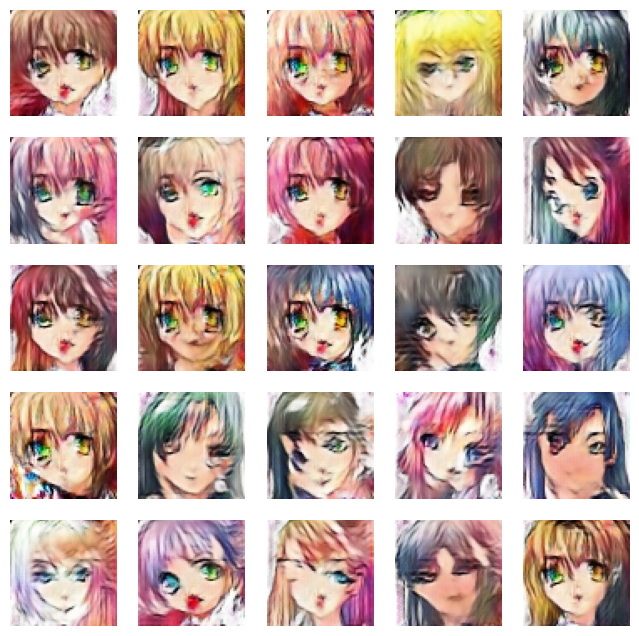

730/730 [==============================] - 58s 80ms/step - d_loss: 0.4742 - g_loss: 1.7995
Epoch 23/50
730/730 [==============================] - ETA: 0s - d_loss: 0.4631 - g_loss: 1.8067

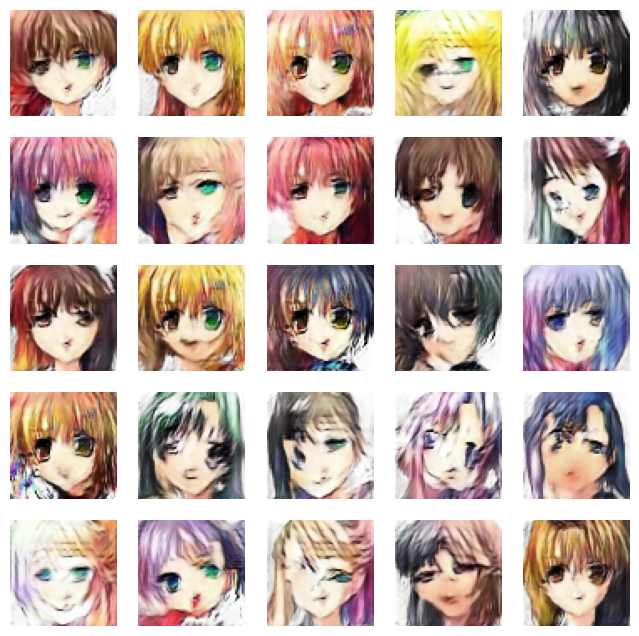

730/730 [==============================] - 58s 79ms/step - d_loss: 0.4631 - g_loss: 1.8067
Epoch 24/50
730/730 [==============================] - ETA: 0s - d_loss: 0.4694 - g_loss: 1.7885

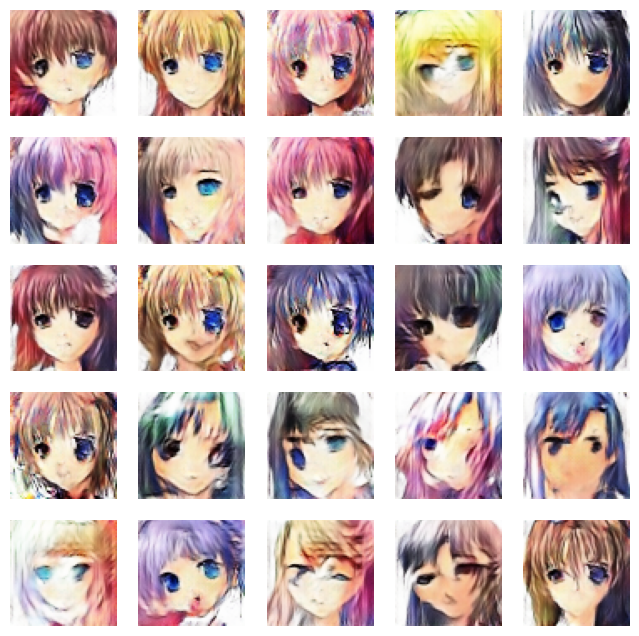

730/730 [==============================] - 58s 80ms/step - d_loss: 0.4694 - g_loss: 1.7885
Epoch 25/50
730/730 [==============================] - ETA: 0s - d_loss: 0.4700 - g_loss: 1.7352

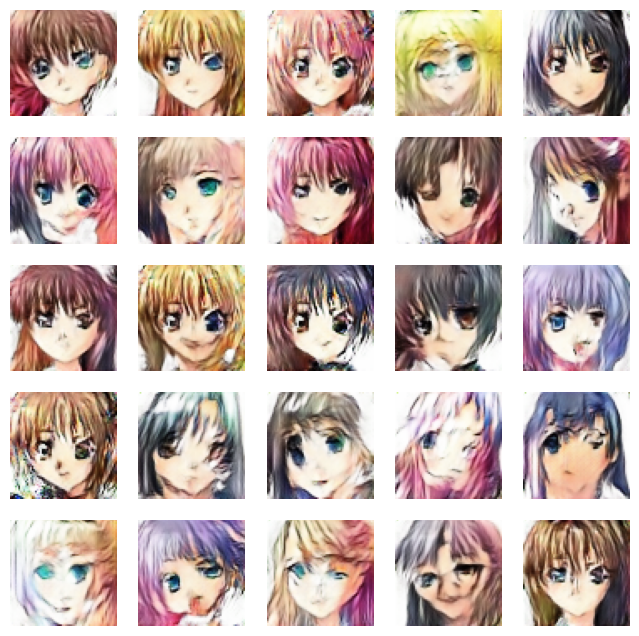

730/730 [==============================] - 58s 80ms/step - d_loss: 0.4700 - g_loss: 1.7352
Epoch 26/50
730/730 [==============================] - ETA: 0s - d_loss: 0.4817 - g_loss: 1.7325

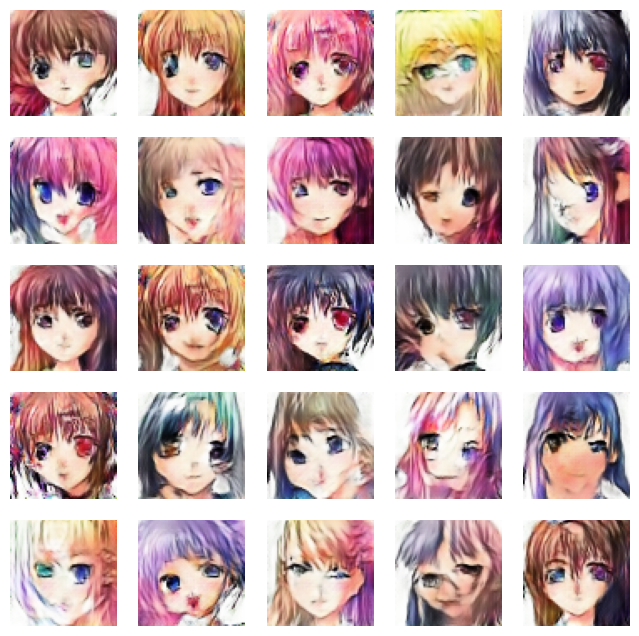

730/730 [==============================] - 58s 80ms/step - d_loss: 0.4817 - g_loss: 1.7325
Epoch 27/50
730/730 [==============================] - ETA: 0s - d_loss: 0.4849 - g_loss: 1.6886

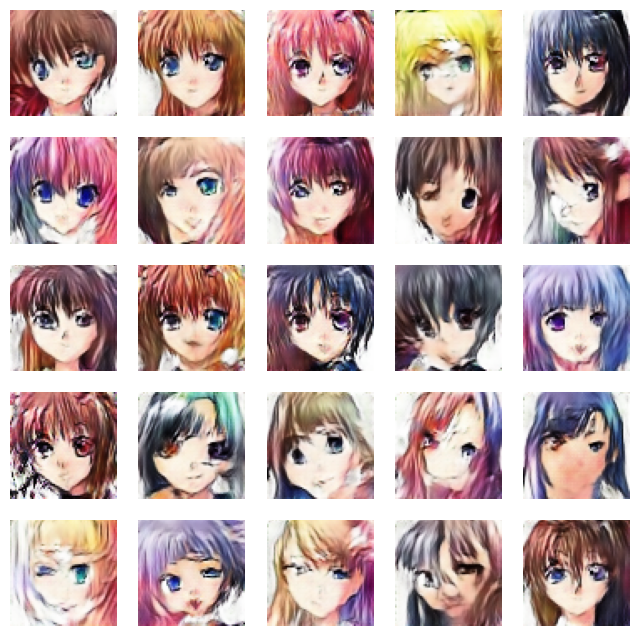

730/730 [==============================] - 58s 80ms/step - d_loss: 0.4849 - g_loss: 1.6886
Epoch 28/50
730/730 [==============================] - ETA: 0s - d_loss: 0.4860 - g_loss: 1.6648

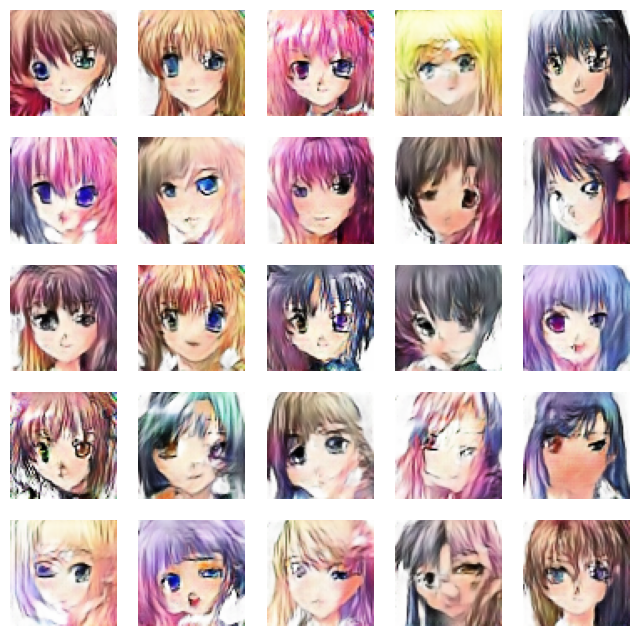

730/730 [==============================] - 58s 79ms/step - d_loss: 0.4860 - g_loss: 1.6648
Epoch 29/50
730/730 [==============================] - ETA: 0s - d_loss: 0.4972 - g_loss: 1.6633

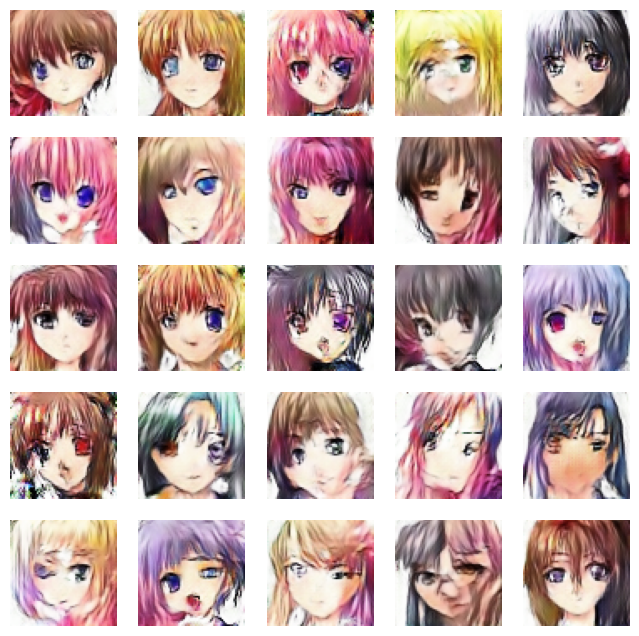

730/730 [==============================] - 58s 80ms/step - d_loss: 0.4972 - g_loss: 1.6633
Epoch 30/50
730/730 [==============================] - ETA: 0s - d_loss: 0.4963 - g_loss: 1.6254

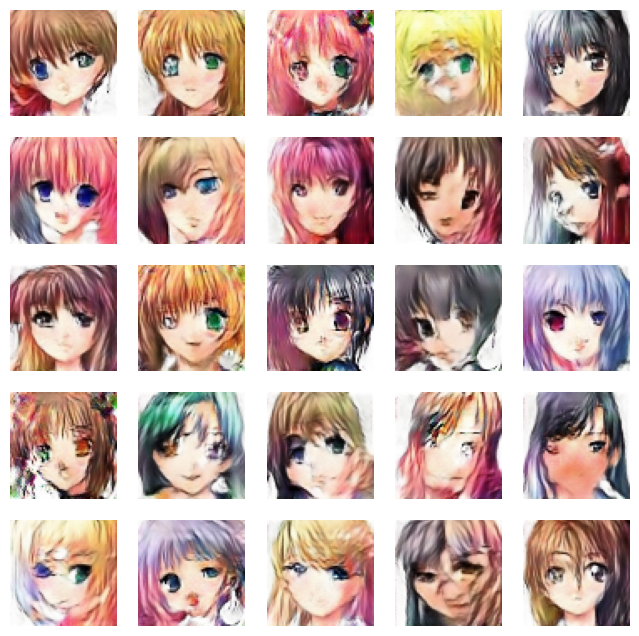

730/730 [==============================] - 58s 80ms/step - d_loss: 0.4963 - g_loss: 1.6254
Epoch 31/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5032 - g_loss: 1.6322

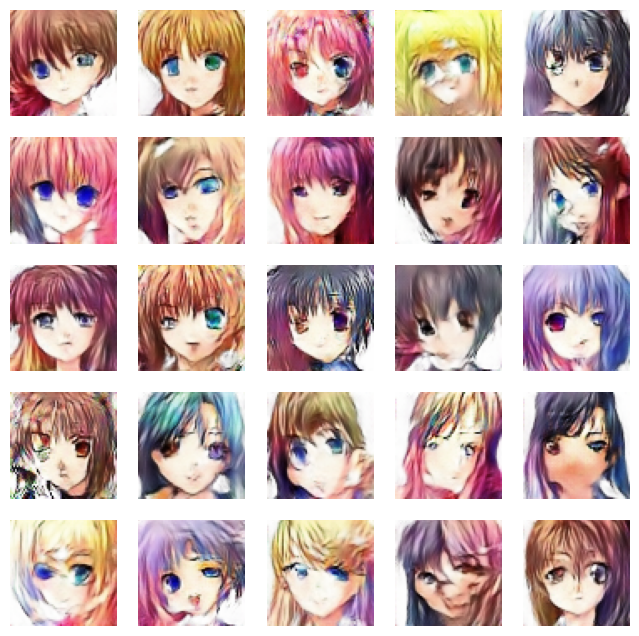

730/730 [==============================] - 61s 84ms/step - d_loss: 0.5032 - g_loss: 1.6322
Epoch 32/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5021 - g_loss: 1.6032

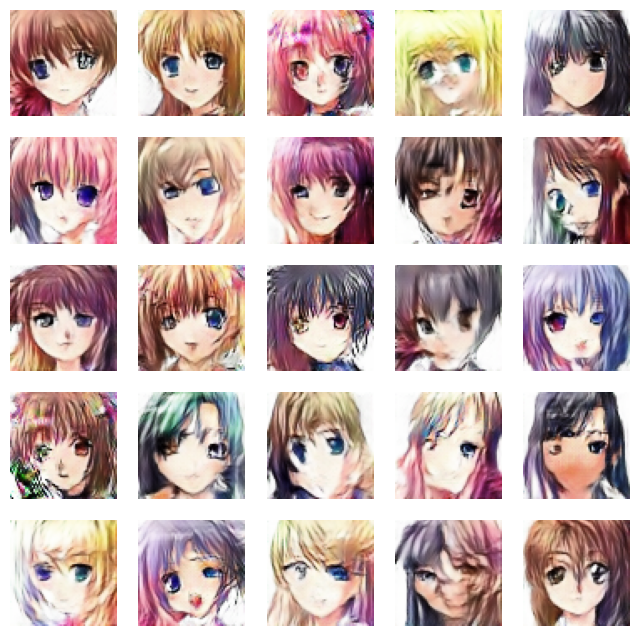

730/730 [==============================] - 58s 79ms/step - d_loss: 0.5021 - g_loss: 1.6032
Epoch 33/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5066 - g_loss: 1.6105

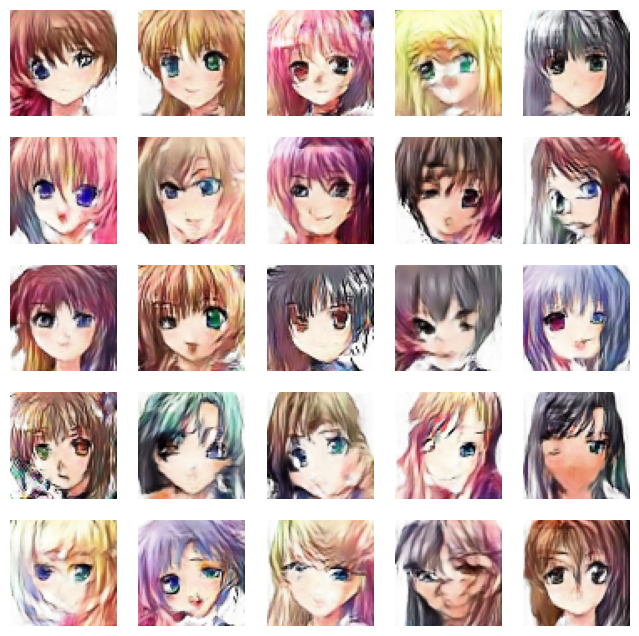

730/730 [==============================] - 58s 80ms/step - d_loss: 0.5066 - g_loss: 1.6105
Epoch 34/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5056 - g_loss: 1.6063

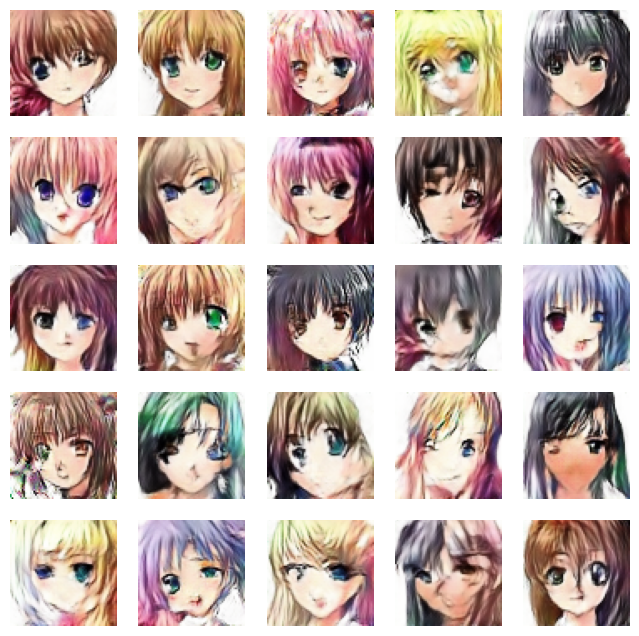

730/730 [==============================] - 58s 80ms/step - d_loss: 0.5056 - g_loss: 1.6063
Epoch 35/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5030 - g_loss: 1.6055

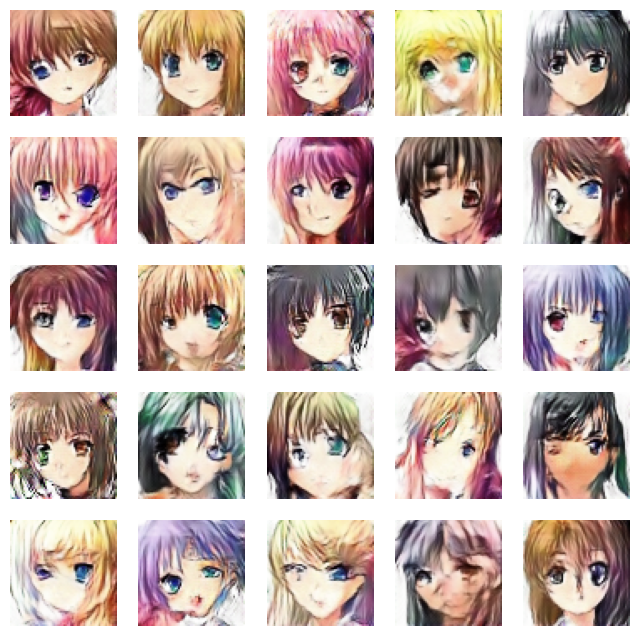

730/730 [==============================] - 58s 80ms/step - d_loss: 0.5030 - g_loss: 1.6055
Epoch 36/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5107 - g_loss: 1.6235

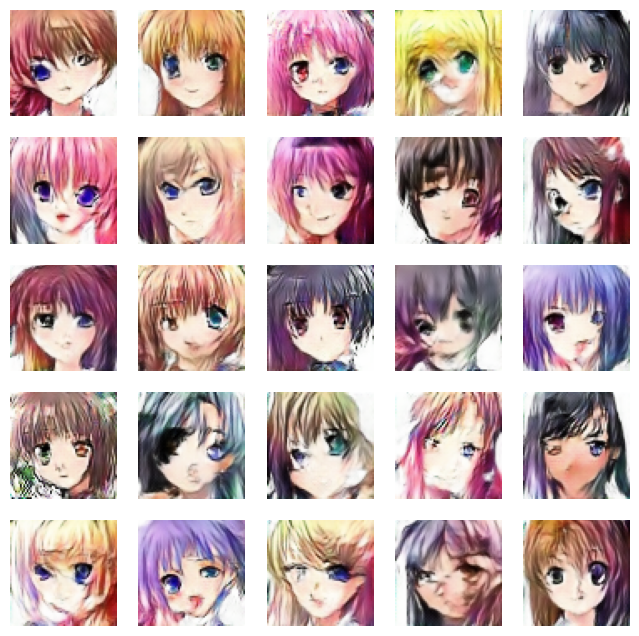

730/730 [==============================] - 58s 80ms/step - d_loss: 0.5107 - g_loss: 1.6235
Epoch 37/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5088 - g_loss: 1.6020

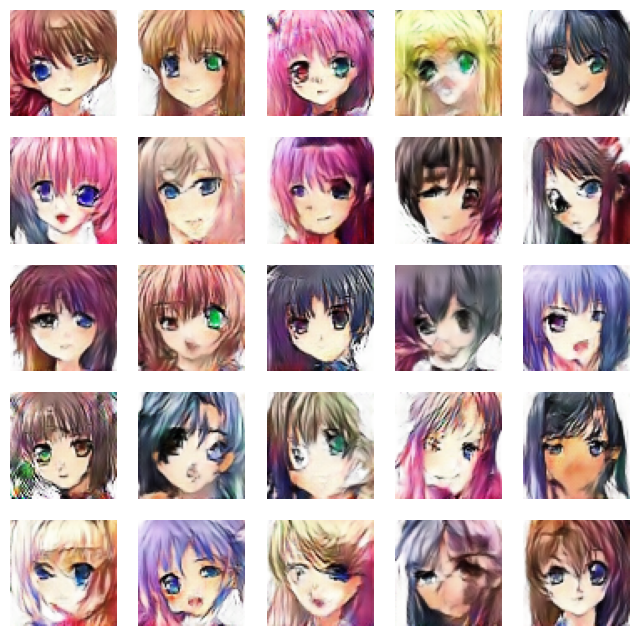

730/730 [==============================] - 58s 80ms/step - d_loss: 0.5088 - g_loss: 1.6020
Epoch 38/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5056 - g_loss: 1.6033

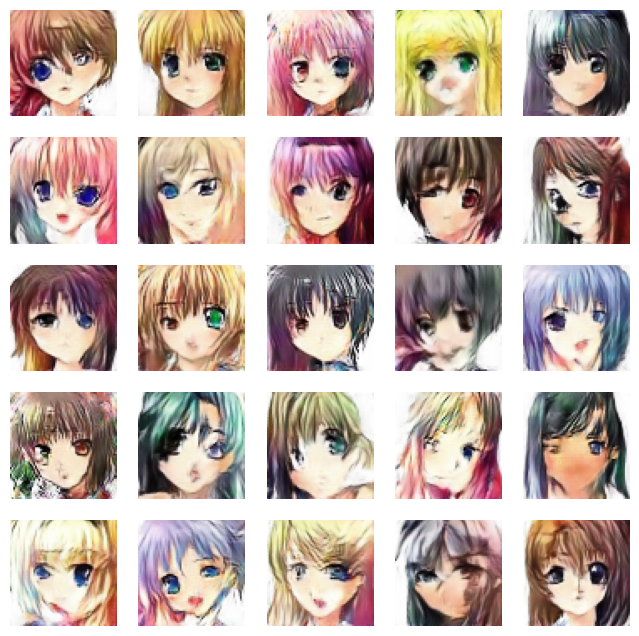

730/730 [==============================] - 58s 80ms/step - d_loss: 0.5056 - g_loss: 1.6033
Epoch 39/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5056 - g_loss: 1.6183

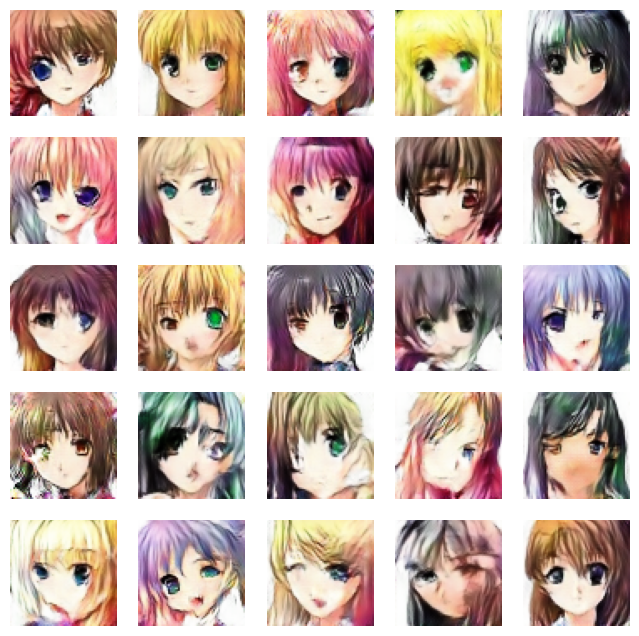

730/730 [==============================] - 58s 80ms/step - d_loss: 0.5056 - g_loss: 1.6183
Epoch 40/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5055 - g_loss: 1.6048

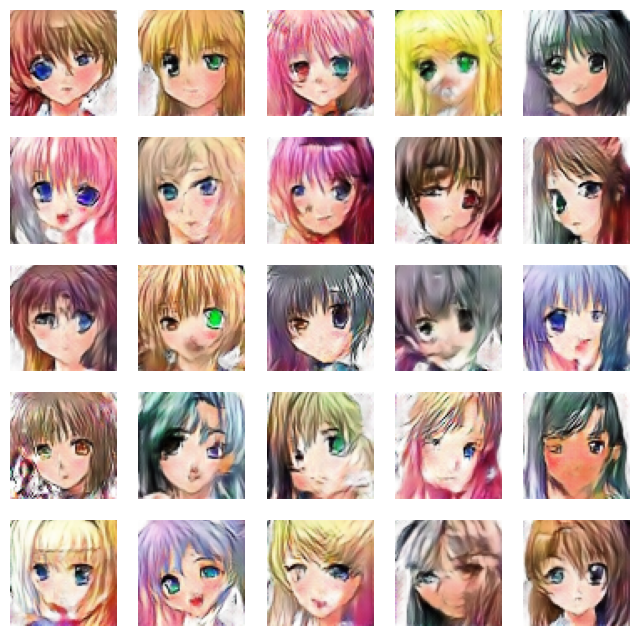

730/730 [==============================] - 58s 80ms/step - d_loss: 0.5055 - g_loss: 1.6048
Epoch 41/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5025 - g_loss: 1.6111

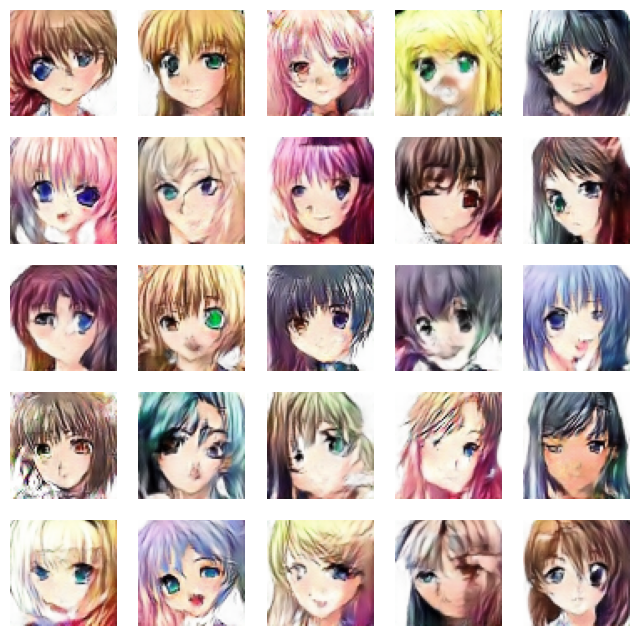

730/730 [==============================] - 58s 80ms/step - d_loss: 0.5025 - g_loss: 1.6111
Epoch 42/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5129 - g_loss: 1.6025

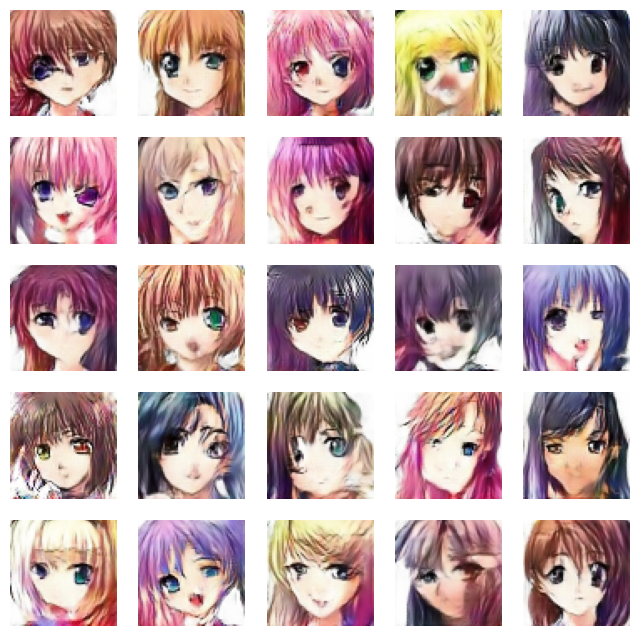

730/730 [==============================] - 58s 80ms/step - d_loss: 0.5129 - g_loss: 1.6025
Epoch 43/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5023 - g_loss: 1.6091

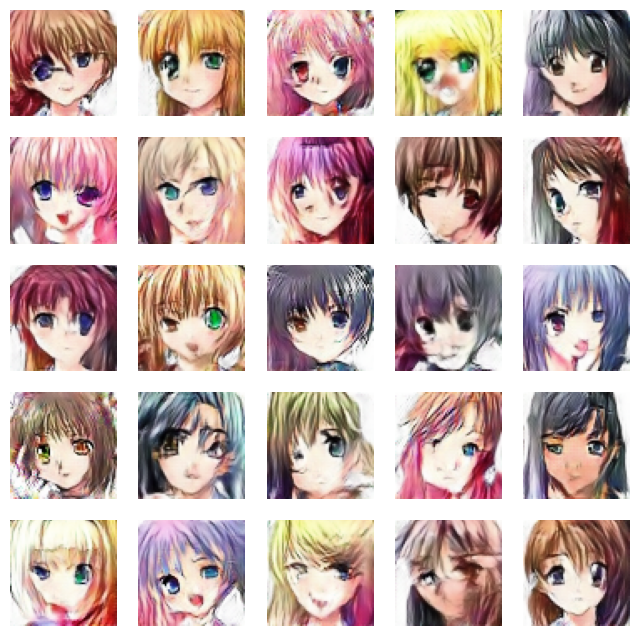

730/730 [==============================] - 58s 79ms/step - d_loss: 0.5023 - g_loss: 1.6091
Epoch 44/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5071 - g_loss: 1.6052

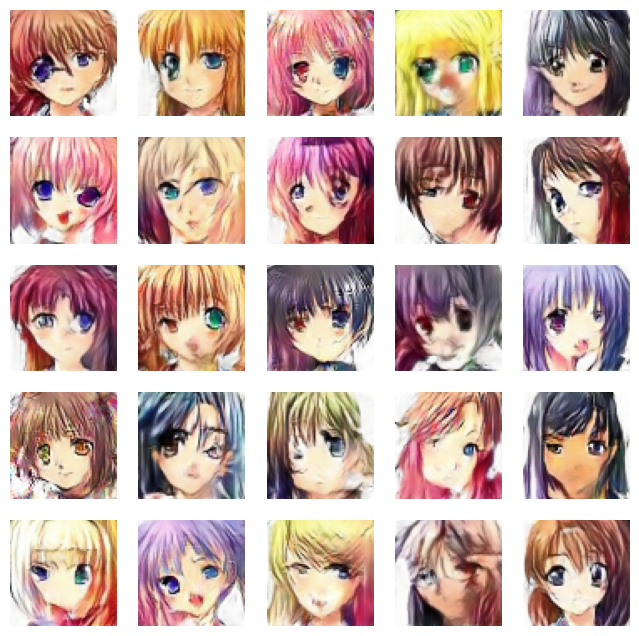

730/730 [==============================] - 58s 80ms/step - d_loss: 0.5071 - g_loss: 1.6052
Epoch 45/50
730/730 [==============================] - ETA: 0s - d_loss: 0.4995 - g_loss: 1.6198

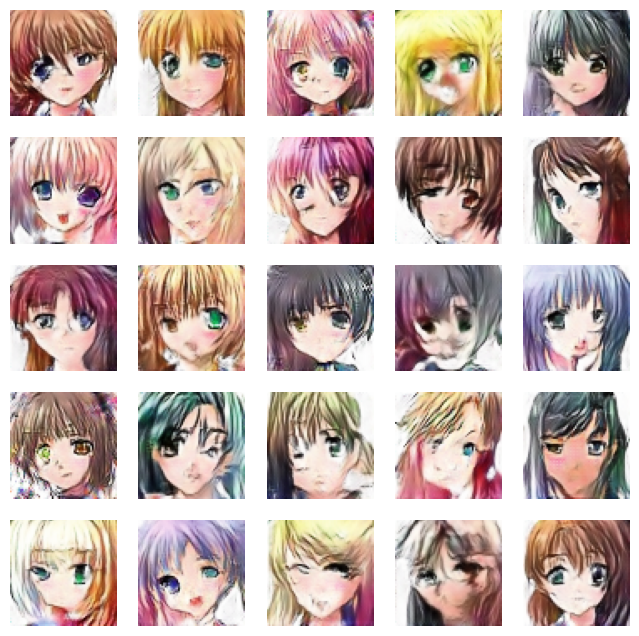

730/730 [==============================] - 58s 80ms/step - d_loss: 0.4995 - g_loss: 1.6198
Epoch 46/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5088 - g_loss: 1.6051

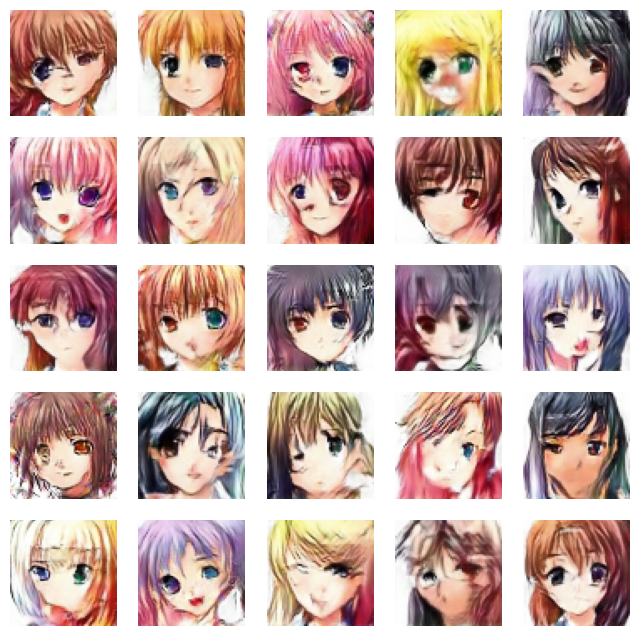

730/730 [==============================] - 58s 80ms/step - d_loss: 0.5088 - g_loss: 1.6051
Epoch 47/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5050 - g_loss: 1.6282

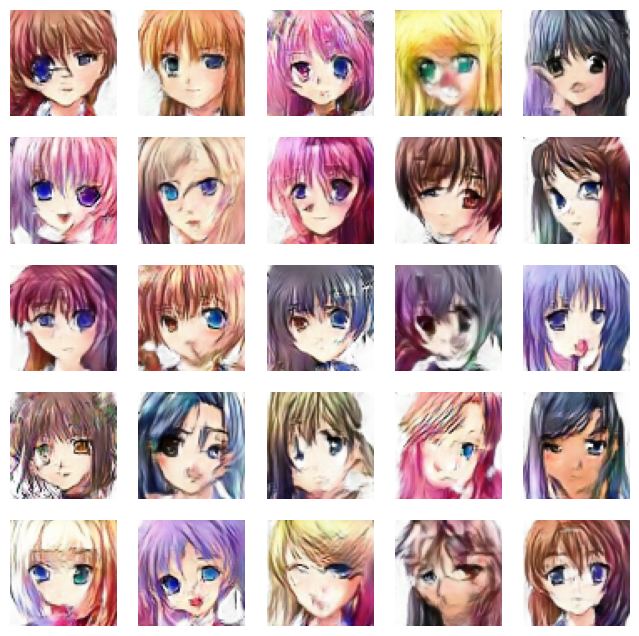

730/730 [==============================] - 58s 80ms/step - d_loss: 0.5050 - g_loss: 1.6282
Epoch 48/50
730/730 [==============================] - ETA: 0s - d_loss: 0.4971 - g_loss: 1.6143

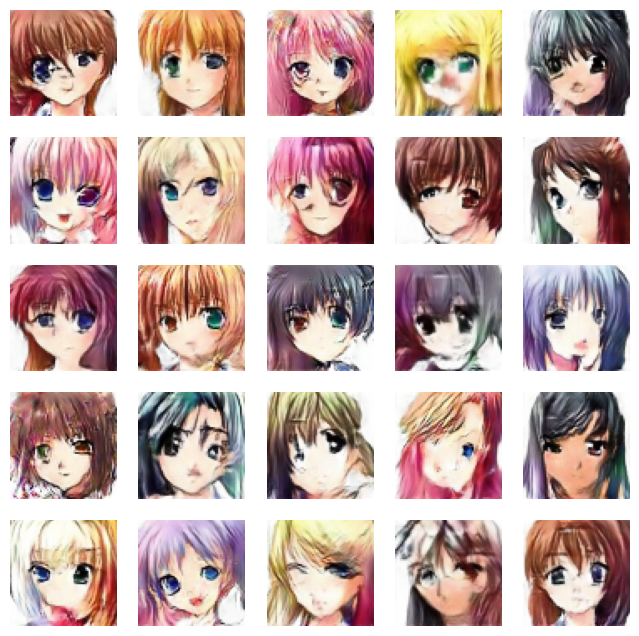

730/730 [==============================] - 58s 79ms/step - d_loss: 0.4971 - g_loss: 1.6143
Epoch 49/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5096 - g_loss: 1.6323

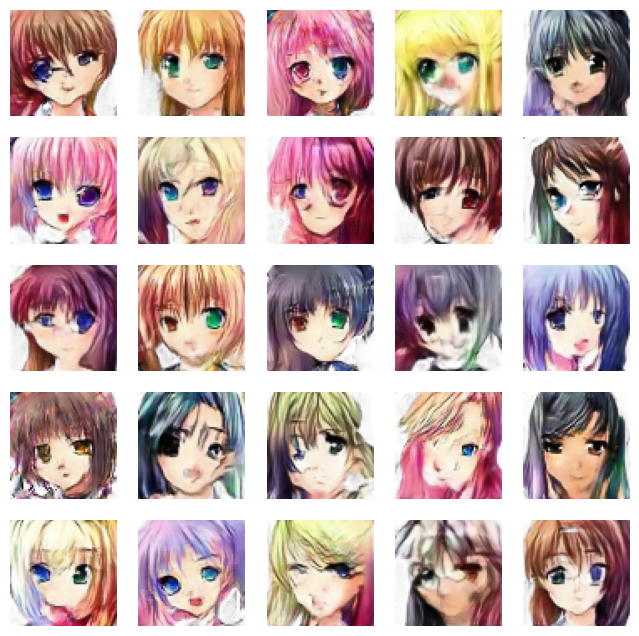

730/730 [==============================] - 58s 80ms/step - d_loss: 0.5096 - g_loss: 1.6323
Epoch 50/50
730/730 [==============================] - ETA: 0s - d_loss: 0.5052 - g_loss: 1.6033

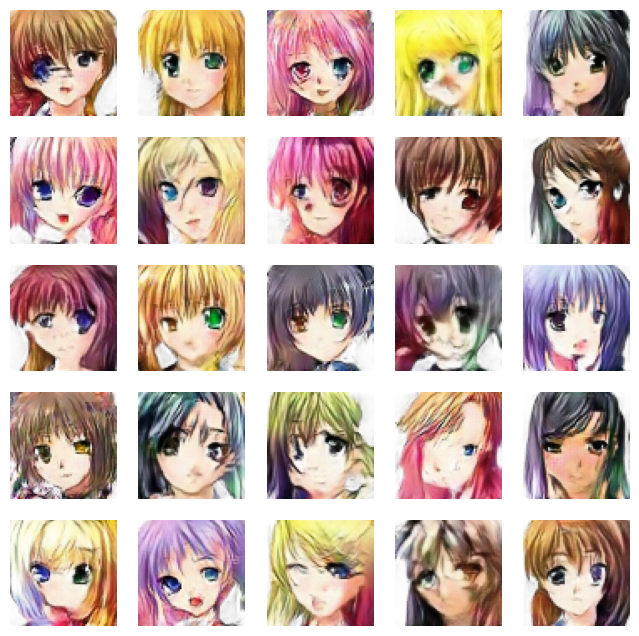

730/730 [==============================] - 58s 79ms/step - d_loss: 0.5052 - g_loss: 1.6033


In [55]:
gan.fit(train_images, epochs = EPOCHS, callbacks = [GANMonitor()])

### Generate new images

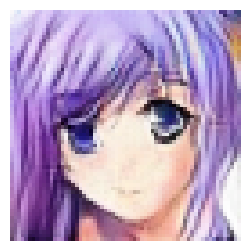

In [60]:
fig = plt.figure(figsize = (3, 3))

# generate image from noise
noise = tf.random.normal([1, 100])
g_img = gan.generator(noise)

# denormalize
g_img = (g_img * 127.5) + 127.5
g_img.numpy()

img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
plt.show()